# CausalNex Structure Model Unpickling

## Import pickle and unpickle structure model

The paths are relative to the Docker image `rbartelme/jupyterlab-pytorch-causalnex:latest` assuming the `a_halleri` github repo is cloned into user `jovyan`'s `/home/` directory

In [1]:
import pickle

#open file
f = open("/home/jovyan/a_halleri/outputs/May07/nt_sm_a_halleri", "rb")

#unpickle via load and store as variable sm
sm = pickle.load(f)

#close file
f.close()

## Test Plotting from Unpickled StructureModel binary

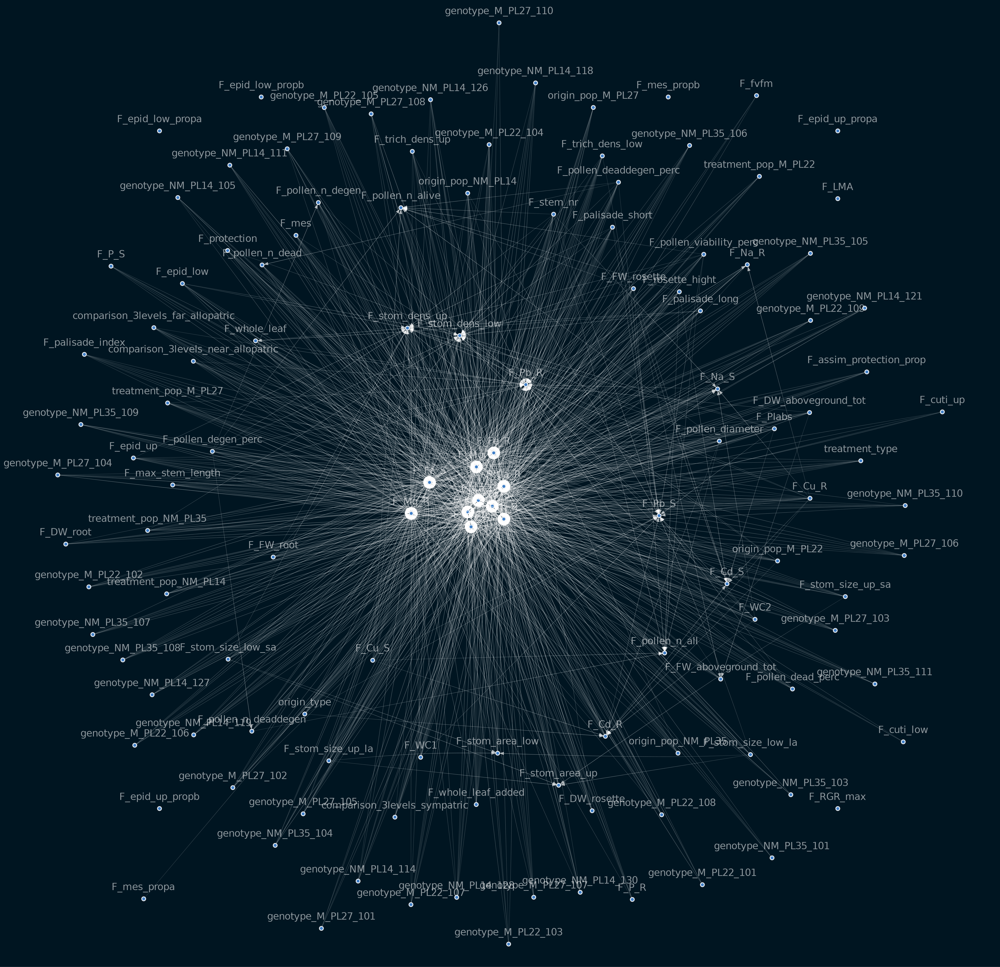

In [2]:
# silence warnings
import warnings
warnings.filterwarnings("ignore")

from IPython.display import Image
from causalnex.plots import plot_structure, NODE_STYLE, EDGE_STYLE

viz = plot_structure(
    sm,
    graph_attributes={"scale": "0.5"},
    all_node_attributes=NODE_STYLE.WEAK,
    all_edge_attributes=EDGE_STYLE.WEAK)
Image(viz.draw(format='png'))


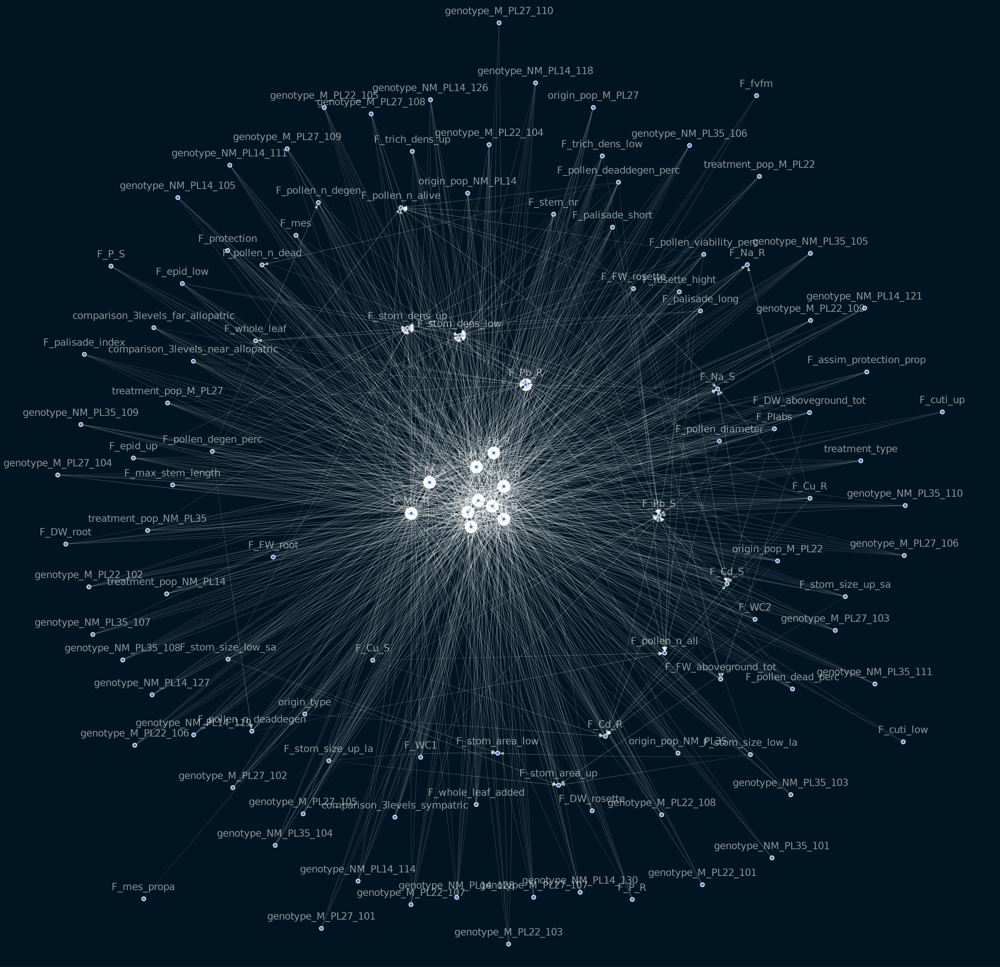

In [3]:
sm = sm.get_largest_subgraph() #drop unconnected nodes

viz = plot_structure(
    sm,
    graph_attributes={"scale": "0.5"},
    all_node_attributes=NODE_STYLE.WEAK,
    all_edge_attributes=EDGE_STYLE.WEAK)
Image(viz.draw(format='png'))

# Discretizing Continuous Variables for Bayesian Network

## Select Continuous Variables

Based on exploratory data analysis, the continuous variables are preprended with `F_`, so `re` can be used to get continuous node names.

In [4]:
import re

nnames = list(sm.nodes()) #convert node names to list for slicing
r = re.compile("F_*") #regex expression compilation
con_var = list(filter(r.match, nnames)) # regex select continuous variables for discretizing 
print(con_var) #sanity check


['F_FW_rosette', 'F_FW_aboveground_tot', 'F_FW_root', 'F_DW_rosette', 'F_DW_aboveground_tot', 'F_DW_root', 'F_WC1', 'F_WC2', 'F_fvfm', 'F_PIabs', 'F_Zn_S', 'F_Cd_S', 'F_Pb_S', 'F_Mg_S', 'F_Ca_S', 'F_K_S', 'F_Na_S', 'F_Cu_S', 'F_Fe_S', 'F_P_S', 'F_Zn_R', 'F_Cd_R', 'F_Pb_R', 'F_Mg_R', 'F_Ca_R', 'F_K_R', 'F_Na_R', 'F_Cu_R', 'F_Fe_R', 'F_P_R', 'F_rosette_hight', 'F_stem_nr', 'F_max_stem_length', 'F_epid_up', 'F_mes', 'F_epid_low', 'F_whole_leaf', 'F_cuti_up', 'F_cuti_low', 'F_stom_size_up_la', 'F_stom_size_up_sa', 'F_stom_area_up', 'F_stom_size_low_la', 'F_stom_size_low_sa', 'F_stom_area_low', 'F_stom_dens_low', 'F_stom_dens_up', 'F_palisade_long', 'F_palisade_short', 'F_trich_dens_up', 'F_trich_dens_low', 'F_whole_leaf_added', 'F_mes_propa', 'F_protection', 'F_assim_protection_prop', 'F_palisade_index', 'F_pollen_n_alive', 'F_pollen_n_dead', 'F_pollen_n_degen', 'F_pollen_n_deaddegen', 'F_pollen_n_all', 'F_pollen_viability_perc', 'F_pollen_dead_perc', 'F_pollen_degen_perc', 'F_pollen_deadd

## Discretize Continuous Variables

Dummy var encoding stays the same, continuous vars will be binned into 10 categories for initial testing

In [6]:
# import pandas and numpy
import pandas as pd
import numpy as np

# setup label encoder to transform non-numeric data into numeric data
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()

# silence warnings
import warnings
warnings.filterwarnings("ignore")

# import causalnex discretizer
from causalnex.discretiser import Discretiser



In [7]:
data = pd.read_csv('~/a_halleri/data/a_halleri_dummy_df.txt', delimiter='\t') #load in dummy var dataset
discretised_data = data.copy() #create a copy of this dataset

discretised_data[con_var].head(5) #sanity check

,F_FW_rosette,F_FW_aboveground_tot,F_FW_root,F_DW_rosette,F_DW_aboveground_tot,F_DW_root,F_WC1,F_WC2,F_fvfm,F_PIabs,...,F_pollen_n_alive,F_pollen_n_dead,F_pollen_n_degen,F_pollen_n_deaddegen,F_pollen_n_all,F_pollen_viability_perc,F_pollen_dead_perc,F_pollen_degen_perc,F_pollen_deaddegen_perc,F_pollen_diameter
0,2.551,2.551,1.125,0.3817,0.3817,0.1730,73.209549,2.733,0.820000,2.8490,...,327.0,2.0,0.0,2.0,329.0,99.39,0.61,0.00,0.607903,15.540000
1,19.641,31.112,1.769,2.4960,5.2850,0.3765,84.513619,5.457,0.776833,3.0610,...,432.0,7.0,1.0,8.0,440.0,98.18,1.59,0.23,1.818182,16.653333
2,7.409,7.409,0.541,0.7470,0.7470,0.1670,88.176796,7.458,0.841000,2.9883,...,540.0,7.0,0.0,7.0,547.0,98.72,1.28,0.00,1.279707,18.220000
3,3.618,11.743,0.628,0.4060,2.1480,0.1890,91.346154,10.556,0.819667,2.4877,...,643.0,28.0,33.0,61.0,704.0,91.34,3.98,4.69,8.664773,17.425000
4,3.208,3.208,1.467,0.8748,0.8748,0.2930,82.474227,4.706,0.767000,1.4732,...,631.0,31.0,3.0,34.0,665.0,94.89,4.66,0.45,5.112782,17.841667


In [10]:
discretised_data["F_FW_rosette"] = Discretiser(method="quantile",
                          num_buckets=4).transform(discretised_data["F_FW_rosette"].values)


ValueError: object of too small depth for desired array